In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [5]:
from fastai.imports import *

from fastai.transforms import *
from fastai.conv_learner import *
from fastai.model import *
from fastai.dataset import *
from fastai.sgdr import *
from fastai.plots import *

PATH = "data/Camera/"
sz=299
arch=resnet18
bs=32

In [6]:
def load_img_id(ds, idx): return np.array(PIL.Image.open(PATH+ds.fnames[idx]))

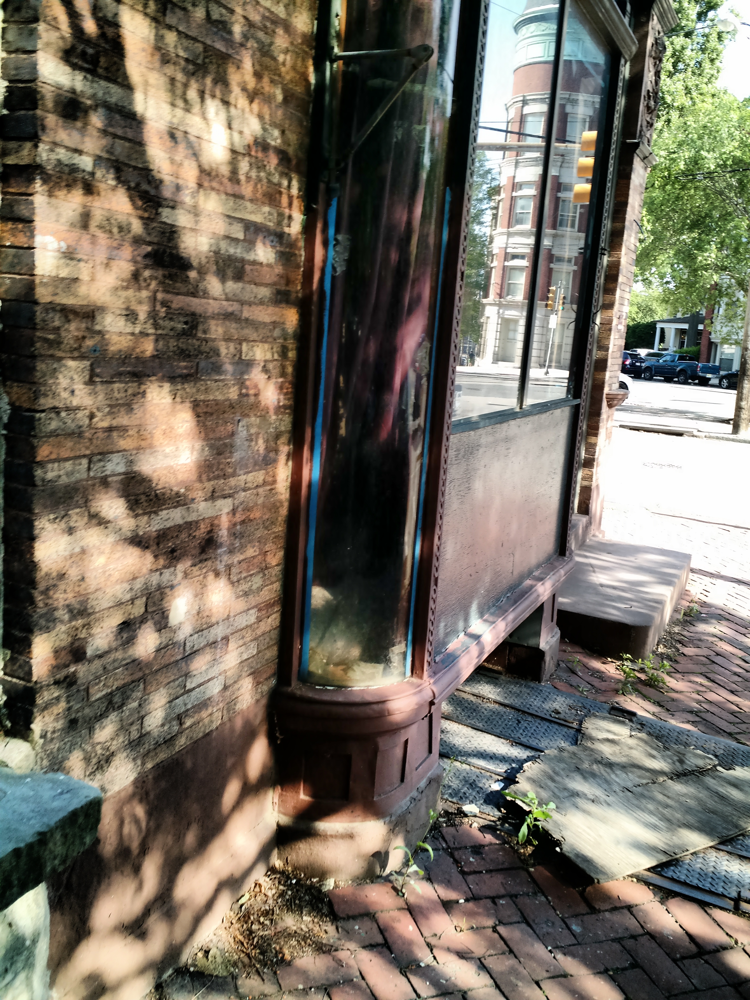

In [12]:
PIL.Image.open(PATH+'train/Motorola-X/(MotoX)120.jpg')

In [7]:
train_path_dir =f"{PATH}train/"

In [25]:
import skimage
import skimage.io
import scipy.misc
import imageio

In [30]:
nimg=scipy.misc.imresize(oi, 0.5, interp='bicubic')
print(nimg.shape)

(1344, 760, 3)


/home/ubuntu/src/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  """Entry point for launching an IPython kernel.


In [26]:
oi=skimage.io.imread(train_files[0])

In [36]:
print(train_files[0][:-4])

data/Camera/train/HTC-1-M7/(HTC-1-M7)210.jpg


In [20]:
#Create Validation Set

In [43]:
train_path = f'{PATH}train/'
train_files = !find {train_path} | grep -i "jpg"

In [39]:
/*for img in train_files:
    original_img=skimage.io.imread(img)
    new_img1=scipy.misc.imresize(original_img, 0.5, interp='bicubic')
    new_img2=scipy.misc.imresize(original_img, 2.0, interp='bicubic')
    new_img3 = skimage.exposure.adjust_gamma(original_img, gamma=0.8)
    new_img4 = skimage.exposure.adjust_gamma(original_img, gamma=1.2)
    skimage.io.imsave( img[:-4] + '_resize_half.jpg',new_img1)
    skimage.io.imsave( img[:-4] + '_resize_two.jpg',new_img2)
    skimage.io.imsave( img[:-4] + '_gamma1.jpg',new_img3)
    skimage.io.imsave( img[:-4] + '_gamma2.jpg',new_img4)

/home/ubuntu/src/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/home/ubuntu/src/anaconda3/envs/fastai/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  after removing the cwd from sys.path.


ValueError: 'arr' does not have a suitable array shape for any mode.

In [40]:
os.mkdir(f'{PATH}valid')
val_path=f'{PATH}valid/'

In [41]:
classes = !ls {train_path}
classes

['HTC-1-M7',
 'iPhone-4s',
 'iPhone-6',
 'LG-Nexus-5x',
 'Motorola-Droid-Maxx',
 'Motorola-Nexus-6',
 'Motorola-X',
 'Samsung-Galaxy-Note3',
 'Samsung-Galaxy-S4',
 'Sony-NEX-7']

In [42]:
for i in classes :os.mkdir(f'{val_path}{i}')

In [44]:
train_files=np.array(train_files)
np.random.shuffle(train_files)
val_img_number = len(train_files)*0.2


In [45]:
val_data = train_files[:int(val_img_number)]
val_data_destination = [x.replace('train', 'valid') for x in val_data]


In [46]:
import shutil
for src, dst in zip(val_data, val_data_destination):
     shutil.move(src, dst)


In [6]:
tfms = tfms_from_model(arch, sz, aug_tfms=transforms_side_on, max_zoom=1.1)
data = ImageClassifierData.from_paths(PATH, tfms=tfms, bs=bs, num_workers=4)

In [6]:
??ConvLearner

In [7]:
learn = ConvLearner.pretrained(arch, data, precompute="True", ps=0.5)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /home/ubuntu/.torch/models/resnet18-5c106cde.pth
100%|██████████| 46827520/46827520 [00:01<00:00, 33400696.49it/s]


100%|██████████| 52/52 [03:34<00:00,  4.12s/it]


In [49]:
learn.lr_find()

HBox(children=(IntProgress(value=0, description='Epoch', max=1), HTML(value='')))

 82%|████████▏ | 170/208 [00:02<00:00, 72.73it/s, loss=10.3]


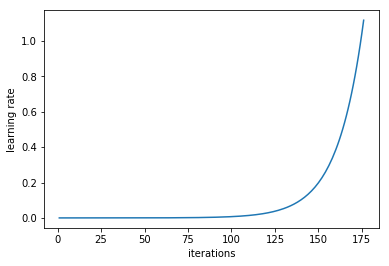

In [50]:
learn.sched.plot_lr()

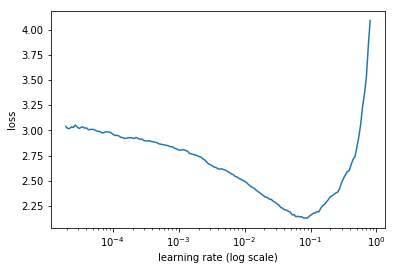

In [51]:
learn.sched.plot()

In [9]:
learn.precompute=False
learn.unfreeze()
lrs = [1e-2/9,1e-2/3, 1e-2]


In [8]:
!rm -rf tmp

In [10]:
lrs = np.array([1e-2/9,1e-2/3, 1e-2])
lr = 1e-2
def get_data(sz,bs):
    tfms = tfms_from_model(arch, sz, aug_tfms=transforms_top_down, max_zoom=1.05)
    return ImageClassifierData.from_paths(PATH, bs=bs, tfms=tfms)

In [11]:
sz=512
bs=32

In [55]:
learn.set_data(get_data(sz,bs))
learn.unfreeze()
learn.fit(lr, 2, cycle_len=1, cycle_mult=1)

HBox(children=(IntProgress(value=0, description='Epoch', max=2), HTML(value='')))

[ 0.       1.5787   1.28809  0.56695]                       
[ 1.       1.33583  1.06357  0.64932]                       



In [13]:
learn.fit(lr, 2, cycle_len=2, cycle_mult=2)

HBox(children=(IntProgress(value=0, description='Epoch', max=6), HTML(value='')))

[ 0.       1.50909  1.2609   0.54048]                       
[ 1.       1.43462  1.22426  0.59345]                       
[ 2.       1.50424  1.36495  0.51786]                       
[ 3.       1.42932  1.2189   0.56786]                       
[ 4.       1.22927  1.13637  0.63095]                       
[ 5.       1.19806  1.16561  0.62976]                       



In [12]:
learn.fit(lrs, 3, cycle_len=1, cycle_mult=2)

HBox(children=(IntProgress(value=0, description='Epoch', max=7), HTML(value='')))

[ 0.       1.19964  0.91621  0.69307]                       
[ 1.       0.69056  0.3838   0.88017]                        
[ 2.       0.39518  0.33061  0.89459]                        
[ 3.       0.42277  0.72974  0.80292]                        
[ 4.       0.25071  0.19592  0.93554]                        
[ 5.       0.13341  0.12336  0.96262]                        
[ 6.       0.12168  0.12315  0.96198]                        



In [13]:
tfms = tfms_from_model(arch, sz, aug_tfms=transforms_top_down, max_zoom=1.05)
data=ImageClassifierData.from_paths(PATH, bs=bs, tfms=tfms, test_name='test')

In [14]:
learn.set_data(data)

In [15]:
log_probs=learn.predict()
log_probs

array([[ -0.00482, -10.6645 , -10.46315, ..., -10.55311,  -7.91277,  -9.85886],
       [ -0.03473,  -6.14489,  -9.71776, ...,  -4.18443,  -4.90881,  -5.03835],
       [ -0.89009,  -6.37396,  -1.88381, ...,  -1.35605,  -1.76195,  -8.45857],
       ..., 
       [ -7.97545, -10.52904, -14.55611, ..., -10.38175,  -9.56057,  -0.00074],
       [ -6.69921, -10.03509,  -9.20437, ...,  -9.16525,  -7.07221,  -0.00326],
       [ -5.39316,  -1.56079,  -6.48326, ...,  -7.12003,  -7.9888 ,  -0.4345 ]], dtype=float32)

In [16]:
probs = np.exp(log_probs)

In [18]:
preds = np.argmax(probs,axis=1)

In [19]:
cm =confusion_matrix(y, preds)

NameError: name 'y' is not defined

In [15]:
test_log_probs,_ = learn.TTA(is_test=True)


In [16]:
test_probs = np.mean(np.exp(test_log_probs), axis=0)
test_preds = np.argmax(test_probs,axis=1)
test_fnames = data.test_ds.fnames
test_fnames = [x.replace(r'test/', '') for x in test_fnames]
test_camera = [data.classes[i] for i in test_preds]
final_sumbit_arr = np.stack((test_fnames,test_camera), axis=1 )
np.savetxt(f'{PATH}submit1.csv', final_sumbit_arr, fmt='%s,%s', header='fname,camera',comments="")


In [17]:
sub=f'{PATH}submit1.csv'

In [18]:
FileLink(sub)

/home/ubuntu/fastai/courses/dl1/data/Camera/submit1.csv